# Train and predict using YoloV5 model

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from enum import Enum
import ast
from tqdm import tqdm
from sklearn import model_selection
import shutil
from glob import glob

In [3]:
# clone yolov5 github repo
os.system("git clone https://github.com/ultralytics/yolov5.git")

0

In [4]:
%cd yolov5
%pip install -r requirements.txt
%cd ..

/content/yolov5
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 34.2 MB/s eta 0:00:00
/content


In [5]:
train = pd.read_csv("https://drive.google.com/uc?id=1WOHXo0AghTKIdtwHMndptCSIKYBG_PKe")
train.head()

,image_id,width,height,bbox,source
0,b6ab77fd7,1024,1024,"[834.0, 222.0, 56.0, 36.0]",usask_1
1,b6ab77fd7,1024,1024,"[226.0, 548.0, 130.0, 58.0]",usask_1
2,b6ab77fd7,1024,1024,"[377.0, 504.0, 74.0, 160.0]",usask_1
3,b6ab77fd7,1024,1024,"[834.0, 95.0, 109.0, 107.0]",usask_1
4,b6ab77fd7,1024,1024,"[26.0, 144.0, 124.0, 117.0]",usask_1


In [6]:
# shape of the ds
train.shape

(147793, 5)

In [7]:
# check no. of unique values for width, height,source and image_ids
train.width.nunique(),train.height.nunique(),train.source.nunique(),train.image_id.nunique()

(1, 1, 7, 3373)

In [8]:
os.getcwd()

'/content'

here, i changed the path from */content*, to the path that contained directly the *train* folder.

In [9]:
%cd ./drive/MyDrive/Colab\ Notebooks/

/content/drive/MyDrive/Colab Notebooks


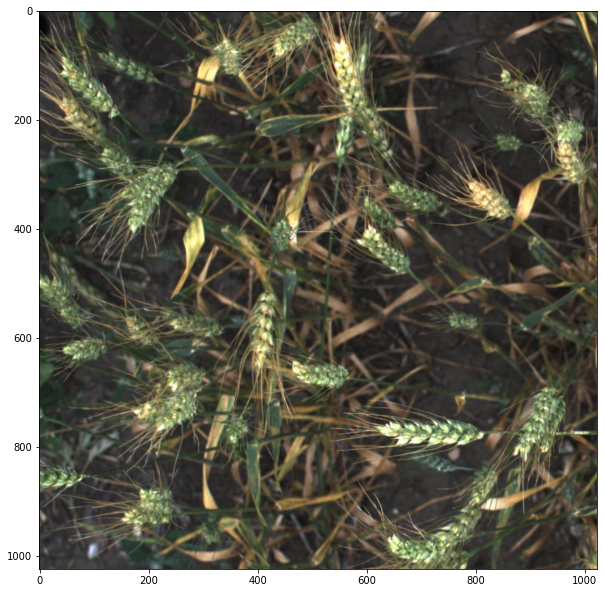

In [10]:
# plot the first image
import cv2

image = train.loc[0,'image_id']
image = os.path.join("train",image + ".jpg")

plt.figure(figsize=(10,15))
img = cv2.imread(image)  
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)    

In [11]:
# check the size of the image
from PIL import Image

img=Image.open(image)
w,h=img.size    # w=Width and h=Height
print("Width =",w,end="\t")
print("Height =",h)

Width = 1024	Height = 1024


In [12]:
# bounding boxes are given as a string, convert them into list
train.bbox = train.bbox.apply(ast.literal_eval)
train.bbox.head()

0     [834.0, 222.0, 56.0, 36.0]
1    [226.0, 548.0, 130.0, 58.0]
2    [377.0, 504.0, 74.0, 160.0]
3    [834.0, 95.0, 109.0, 107.0]
4    [26.0, 144.0, 124.0, 117.0]
Name: bbox, dtype: object

In [13]:
# group the records by image id, so that we have cordinates of all the objects present in an image 
# as list of lists, name the new colum as bboxes
train = train.groupby("image_id")["bbox"].apply(list).reset_index(name="bboxes")

In [14]:
# check the updated dataset
train.head()

,image_id,bboxes
0,00333207f,"[[0, 654, 37, 111], [0, 817, 135, 98], [0, 192..."
1,005b0d8bb,"[[765.0, 879.0, 116.0, 79.0], [84.0, 539.0, 15..."
2,006a994f7,"[[437.0, 988.0, 98.0, 36.0], [309.0, 527.0, 11..."
3,00764ad5d,"[[89.0, 256.0, 113.0, 107.0], [216.0, 282.0, 1..."
4,00b5fefed,"[[709.0, 97.0, 204.0, 105.0], [775.0, 250.0, 1..."


In [15]:
# train test split
df_train,df_valid = model_selection.train_test_split(
    train,
    test_size=0.1,
    random_state=42,
    shuffle=True
)

In [16]:
# drop the index
df_train = df_train.reset_index(drop=True)
df_valid = df_valid.reset_index(drop=True)

In [17]:
%cd ../../..
os.getcwd()

/content


'/content'

In [18]:
# using os instead of pasting in cmd
os.system(
    f'''
    cd ./yolov5
    mkdir output 
    cd output
    mkdir images
    mkdir labels
    cd images
    mkdir train
    mkdir validation
    cd ..
    cd labels
    mkdir train
    mkdir validation
    cd ../
    '''
)

0

In [19]:
!apt-get install tree

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following NEW packages will be installed:
  tree
0 upgraded, 1 newly installed, 0 to remove and 21 not upgraded.
Need to get 40.7 kB of archives.
After this operation, 105 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tree amd64 1.7.0-5 [40.7 kB]
Fetched 40.7 kB in 0s (123 kB/s)
Selecting previously unselected package tree.
(Reading database ... 124016 files and directories currently installed.)
Preparing to unpack .../tree_1.7.0-5_amd64.deb ...
Unpacking tree (1.7.0-5) ...
Setting up tree (1.7.0-5) ...
Processing triggers for man-db (2.8.3-2ubuntu0.1) ...


In [20]:
!tree -d ./yolov5/output

./yolov5/output
├── images
│   ├── train
│   └── validation
└── labels
    ├── train
    └── validation

6 directories


In [21]:
# Define path
DATA_PATH ="./drive/MyDrive/Colab Notebooks/" # this is where training and test images are saved
OUTPUT_PATH = "./yolov5/output/" 
IMG_SIZE = 1024
label = 0 #tag
EPOCHS = 15 #20
BATCH_SIZE = 16 #8 ~min

In [22]:
# helper function to convert the data into yolo format
# also copy images from train/test folder to yolov5 folder

def process_data(data,data_type=train):
    for _,row in tqdm(data.iterrows()):
        image_name = row.image_id
        bounding_boxes = row.bboxes
        
        yolo_data = []

        for bbox in bounding_boxes:
            x = bbox[0]
            y = bbox[1]
            w = bbox[2]
            h = bbox[3]
            
            x_center = x + w/2
            y_center = y + h/2
            
            x_center, y_center, w, h = tuple(map(lambda x: x/IMG_SIZE, (x_center, y_center, w, h)))
            yolo_data.append([label,x_center,y_center,w,h])
            
        yolo_data = np.array(yolo_data)
        np.savetxt(
        os.path.join(OUTPUT_PATH,f"labels/{data_type}/{image_name}.txt"),
            yolo_data,
            fmt=["%d","%f","%f","%f","%f"]
        )
            
        shutil.copyfile(
        os.path.join(DATA_PATH,f"train/{image_name}.jpg"),
        os.path.join(OUTPUT_PATH,f"images/{data_type}/{image_name}.jpg"),
        )

In [23]:
# execute above function
process_data(df_train,data_type="train")
process_data(df_valid,data_type="validation")

3035it [13:25,  3.77it/s]
338it [01:23,  4.07it/s]


In [24]:
# verify whether images copied correctly or not
train_images= glob("./yolov5/output/images/train/*.jpg")
validation_images= glob("./yolov5/output/images/validation/*.jpg")
print("no. of training images copied:{},\nno. of test images copied:{}".format(len(train_images),len(validation_images)))

no. of training images copied:3035,
no. of test images copied:338


In [25]:
# verify whether labels are saved correctly or not
train_labels= glob("./yolov5/output/labels/train/*.txt")
validation_labels= glob("./yolov5/output/labels/validation/*.txt")
print("no. of training labels saved:{},\nno. of test labels copied:{}".format(len(train_labels),len(validation_labels)))

no. of training labels saved:3035,
no. of test labels copied:338


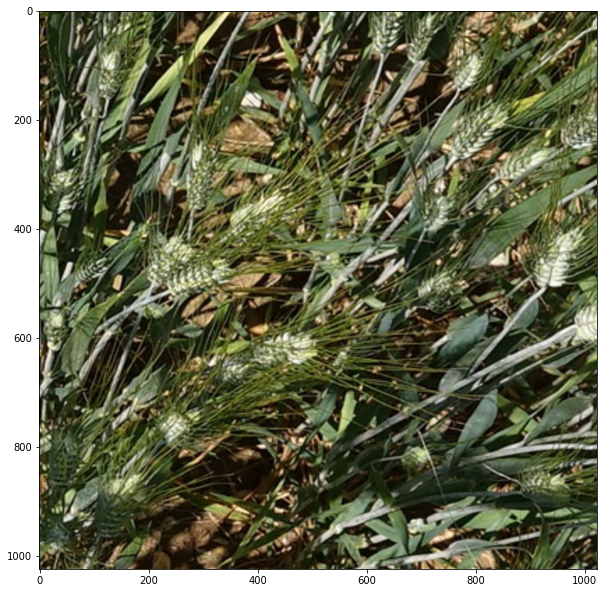

In [26]:
# check the first image saved in the yolov5 folder
import cv2

image = train_images[0]

plt.figure(figsize=(10,15))
img = cv2.imread(image)   
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)    

In [27]:
!head -10 "./yolov5/output/labels/train/00333207f.txt" 

0 0.018066 0.692871 0.036133 0.108398
0 0.065918 0.845703 0.131836 0.095703
0 0.010742 0.227051 0.021484 0.079102
0 0.034668 0.352539 0.061523 0.037109
0 0.120117 0.365723 0.080078 0.079102
0 0.052734 0.312988 0.046875 0.047852
0 0.206055 0.334961 0.068359 0.052734
0 0.205566 0.147949 0.067383 0.049805
0 0.218750 0.078613 0.041016 0.083008
0 0.046387 0.166992 0.086914 0.056641


In [28]:
OUTPUT_PATH = "./output"
with open(f"./yolov5/ws_data.yaml", "w+") as file_:
        file_.write(
            f"""
            
            train: {OUTPUT_PATH}/images/train
            val: {OUTPUT_PATH}/images/validation
            nc: 1
            names: ["wheat"]
            
            """
        )

In [29]:
!cat "./yolov5/ws_data.yaml"


            
            train: ./output/images/train
            val: ./output/images/validation
            nc: 1
            names: ["wheat"]
            
            

In [30]:
def trainYoloModel(model_name: str,preTrainedWeights_path = None):
    """
    train YOLO v5 models
    
    """
    mapper = {}
    for idx, model_ in enumerate(glob("yolov5/models/*yaml")):
        mapper[idx + 1] = model_
        print(f"{idx + 1} =>  {model_.split('/')[-1].split('.')[0]}")

    model = mapper[2]
    
    !python yolov5/train.py --img {IMG_SIZE} --batch {BATCH_SIZE} --epochs {EPOCHS} --data yolov5/ws_data.yaml --cfg {model} --name {model_name}
            

In [31]:
trainYoloModel(model_name = "ws_yolov5",preTrainedWeights_path = None) #training

1 =>  yolov5l
2 =>  yolov5s
3 =>  yolov5m
4 =>  yolov5x
5 =>  yolov5n
train: weights=yolov5/yolov5s.pt, cfg=yolov5/models/yolov5s.yaml, data=yolov5/ws_data.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=15, batch_size=16, imgsz=1024, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=yolov5/runs/train, name=ws_yolov5, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-63-gcdd804d Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=

In [32]:
!tree -f yolov5/runs

yolov5/runs
└── yolov5/runs/train
    └── yolov5/runs/train/ws_yolov5
        ├── yolov5/runs/train/ws_yolov5/confusion_matrix.png
        ├── yolov5/runs/train/ws_yolov5/events.out.tfevents.1673379590.f735ac91690e.4440.0
        ├── yolov5/runs/train/ws_yolov5/F1_curve.png
        ├── yolov5/runs/train/ws_yolov5/hyp.yaml
        ├── yolov5/runs/train/ws_yolov5/labels_correlogram.jpg
        ├── yolov5/runs/train/ws_yolov5/labels.jpg
        ├── yolov5/runs/train/ws_yolov5/opt.yaml
        ├── yolov5/runs/train/ws_yolov5/P_curve.png
        ├── yolov5/runs/train/ws_yolov5/PR_curve.png
        ├── yolov5/runs/train/ws_yolov5/R_curve.png
        ├── yolov5/runs/train/ws_yolov5/results.csv
        ├── yolov5/runs/train/ws_yolov5/results.png
        ├── yolov5/runs/train/ws_yolov5/train_batch0.jpg
        ├── yolov5/runs/train/ws_yolov5/train_batch1.jpg
        ├── yolov5/runs/train/ws_yolov5/train_batch2.jpg
        ├── yolov5/runs/train/ws_yolov5/val_batch0_labels.jpg
        ├── yolov5/

In [34]:
os.getcwd()

'/content'

In [38]:
# function to make predictions
def predict(images_path:"path to the test images", weights_path: "path to the weights folder"):
    """
    make predictions over images using Yolo
    """
    !python yolov5/detect.py --source {images_path} --weights {weights_path}

predict(images_path = "drive/MyDrive/Colab\ Notebooks/test", weights_path = "yolov5/runs/train/ws_yolov5/weights/best.pt")

detect: weights=['yolov5/runs/train/ws_yolov5/weights/best.pt'], source=drive/MyDrive/Colab Notebooks/test, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-63-gcdd804d Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/10 /content/drive/MyDrive/Colab Notebooks/test/2fd875eaa.jpg: 640x640 30 wheats, 12.6ms
image 2/10 /content/drive/MyDrive/Colab Notebooks/test/348a992bb.jpg: 640x640 36 wheats, 12.6ms
image 3/10 /content/drive/MyDrive/Colab Notebooks/test/51b3e36ab.jpg: 640x640 28 wheats, 12.6ms
image 4/10 /con

In [39]:
# images with bbox saved in exp folder
!tree -f yolov5/runs/detect/exp

yolov5/runs/detect/exp
├── yolov5/runs/detect/exp/2fd875eaa.jpg
├── yolov5/runs/detect/exp/348a992bb.jpg
├── yolov5/runs/detect/exp/51b3e36ab.jpg
├── yolov5/runs/detect/exp/51f1be19e.jpg
├── yolov5/runs/detect/exp/53f253011.jpg
├── yolov5/runs/detect/exp/796707dd7.jpg
├── yolov5/runs/detect/exp/aac893a91.jpg
├── yolov5/runs/detect/exp/cb8d261a3.jpg
├── yolov5/runs/detect/exp/cc3532ff6.jpg
└── yolov5/runs/detect/exp/f5a1f0358.jpg

0 directories, 10 files


#### Test and visualize some of the images with skimage


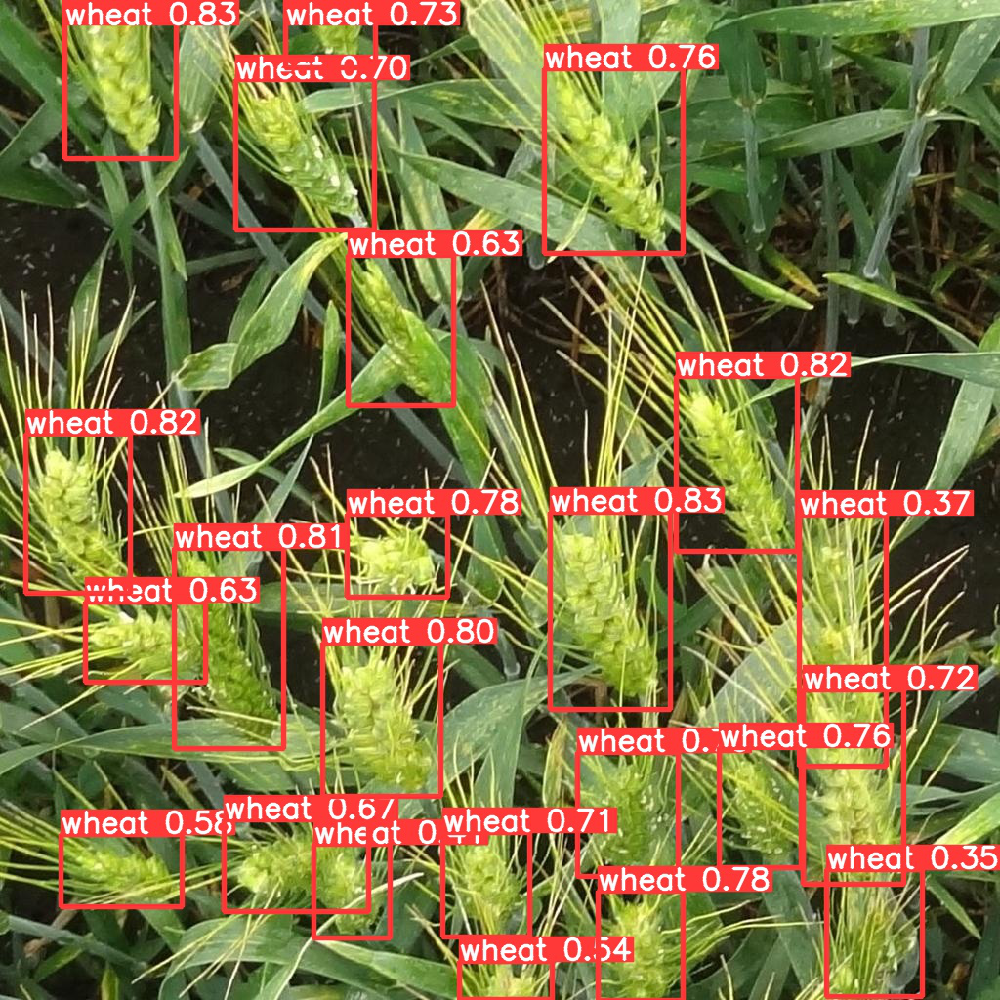


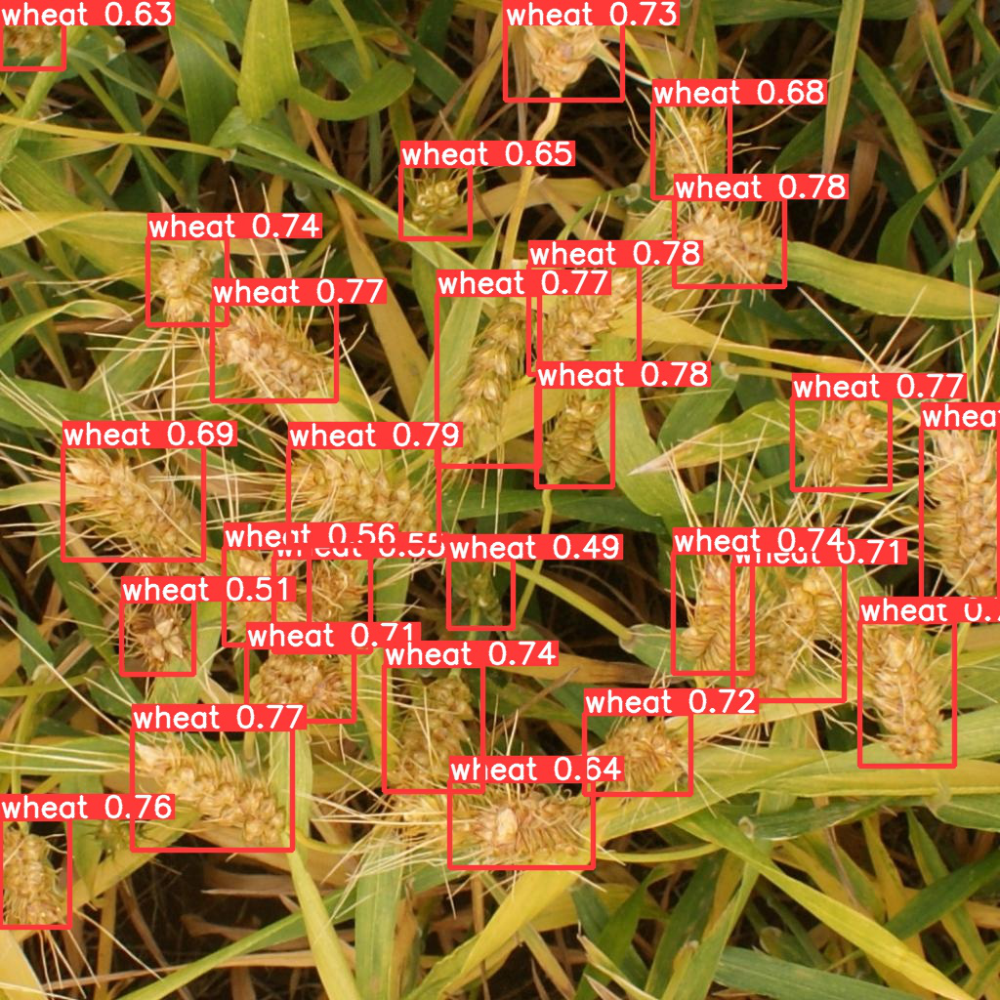


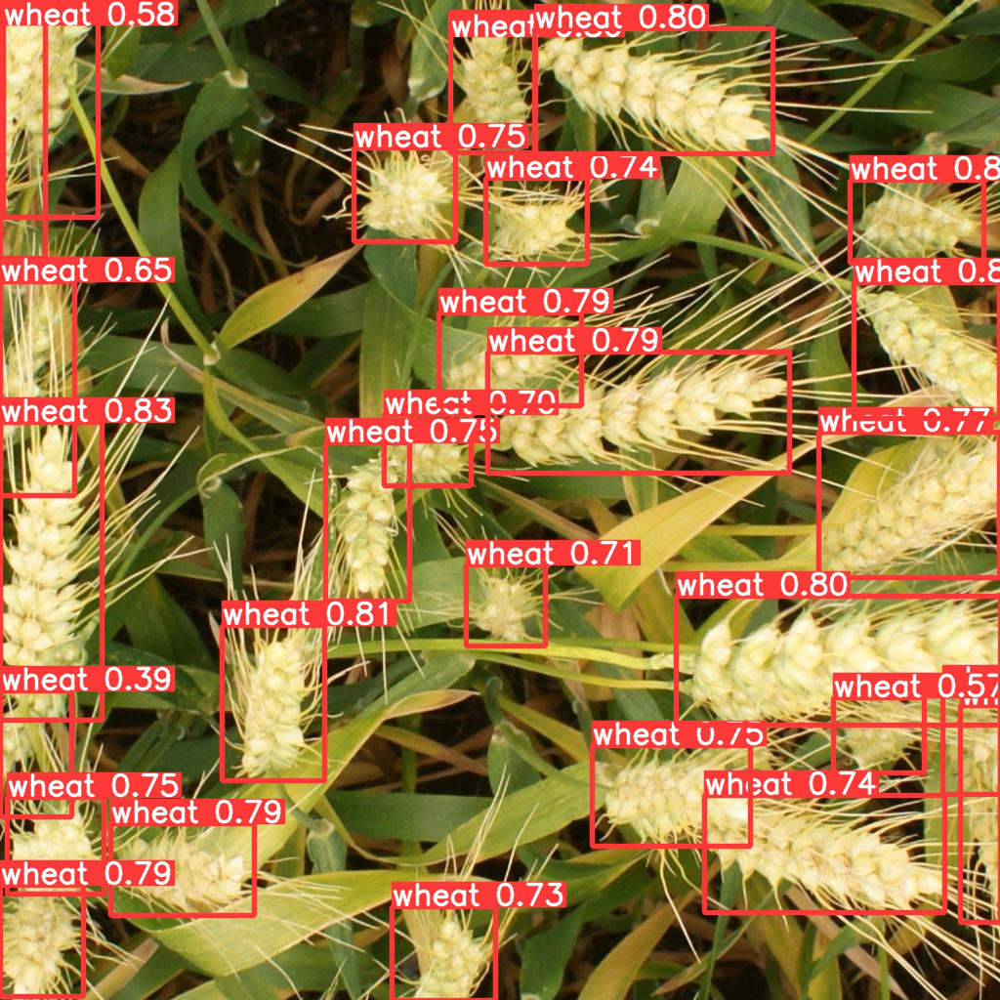


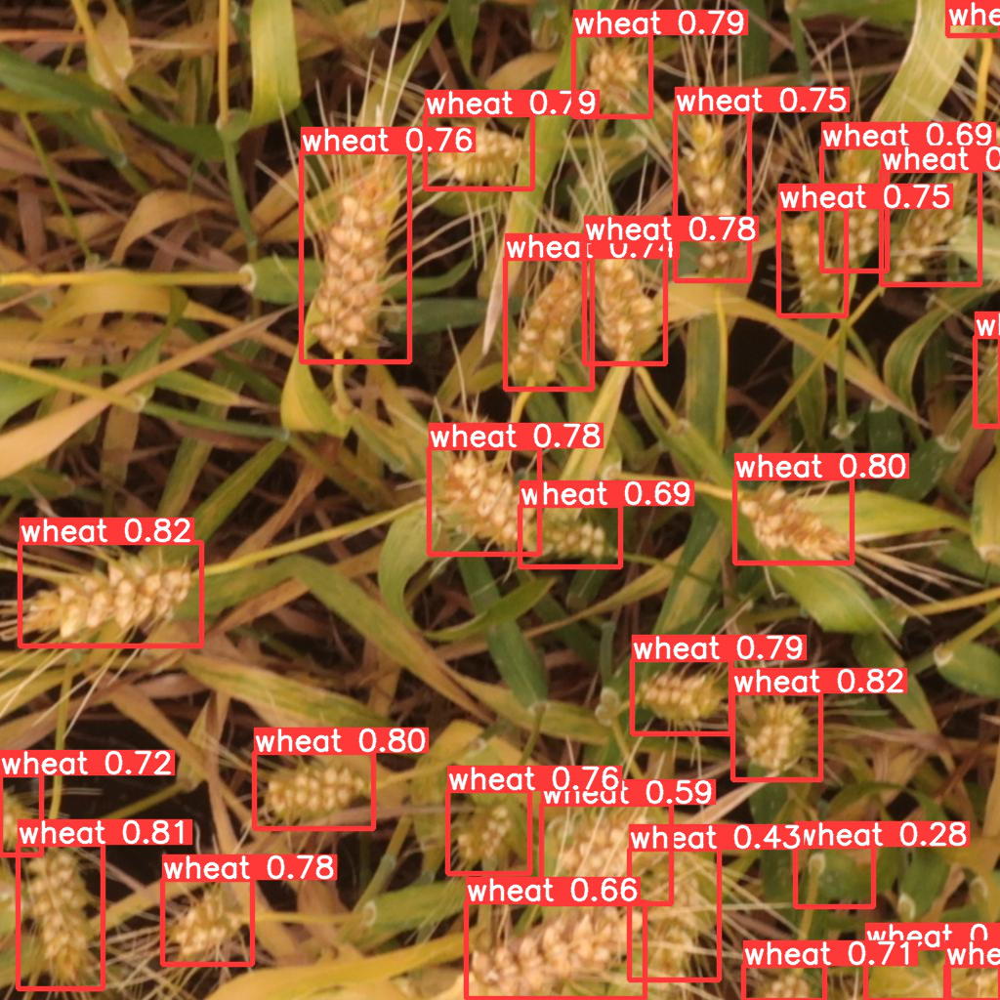


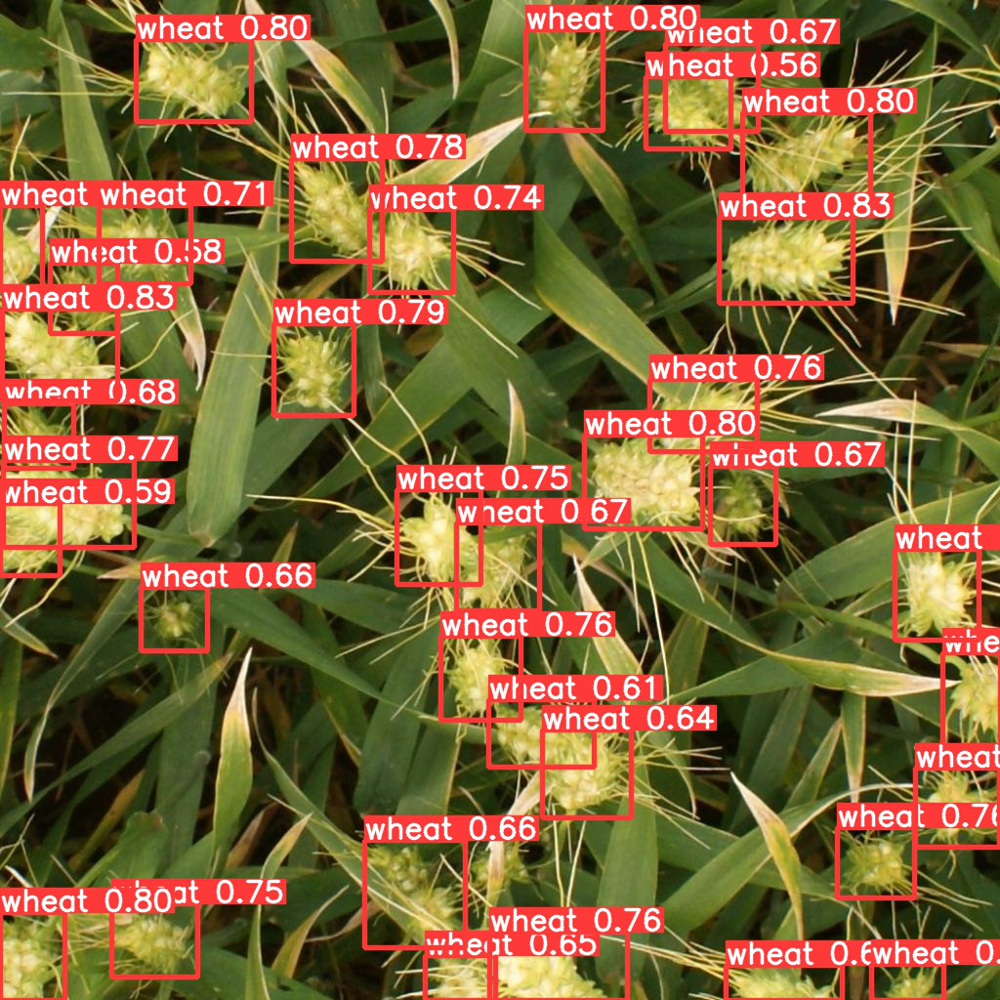


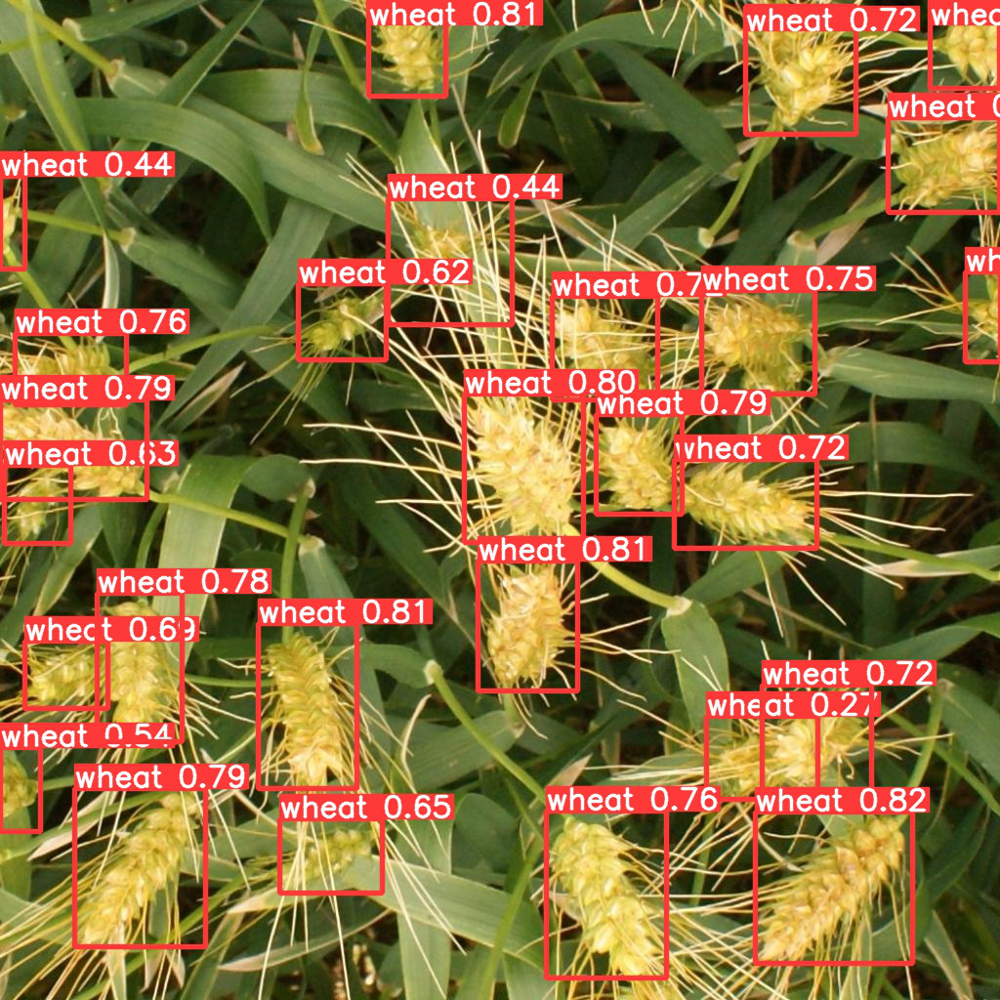


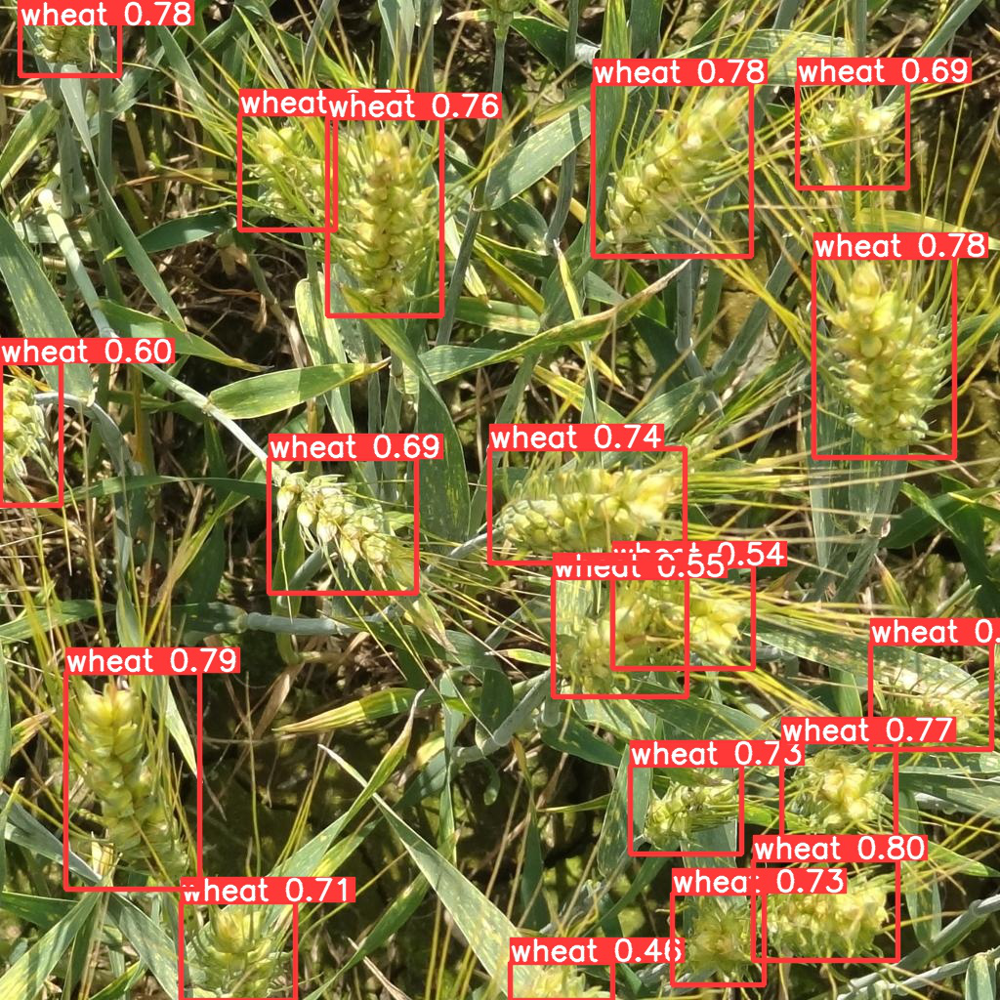


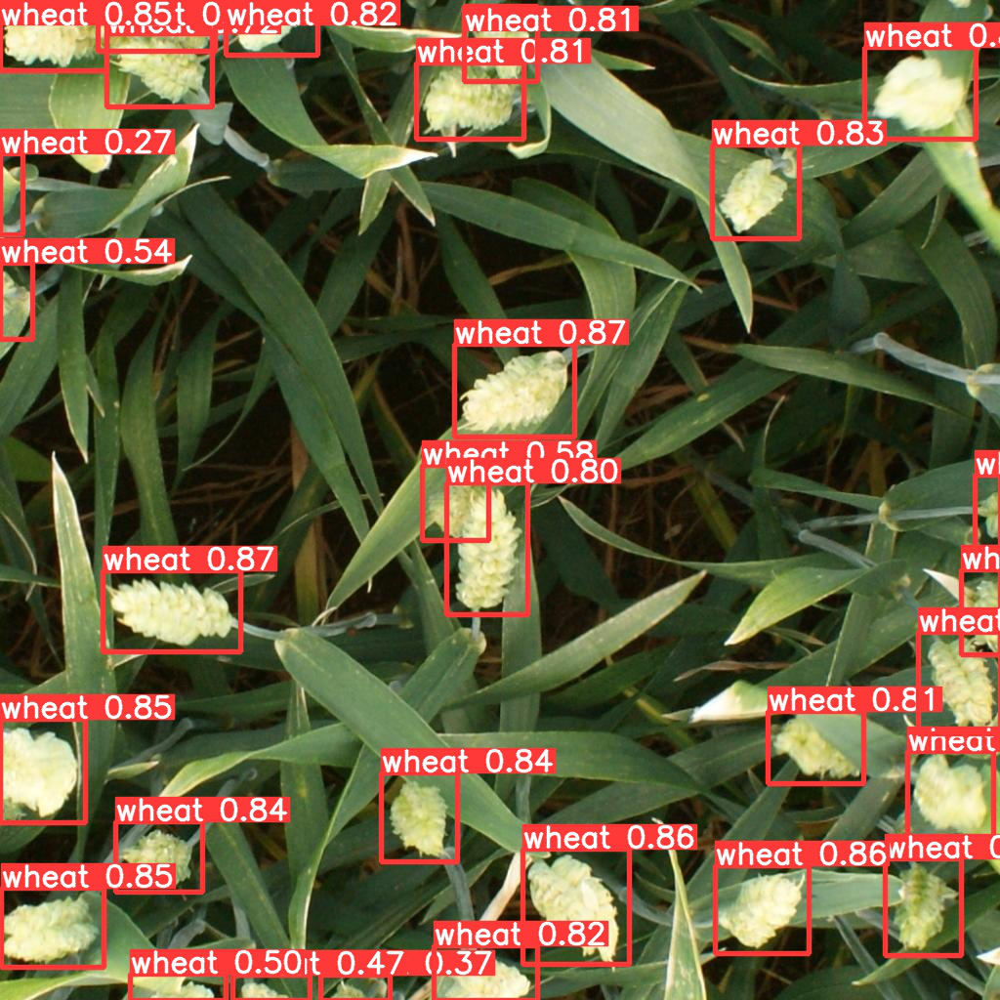


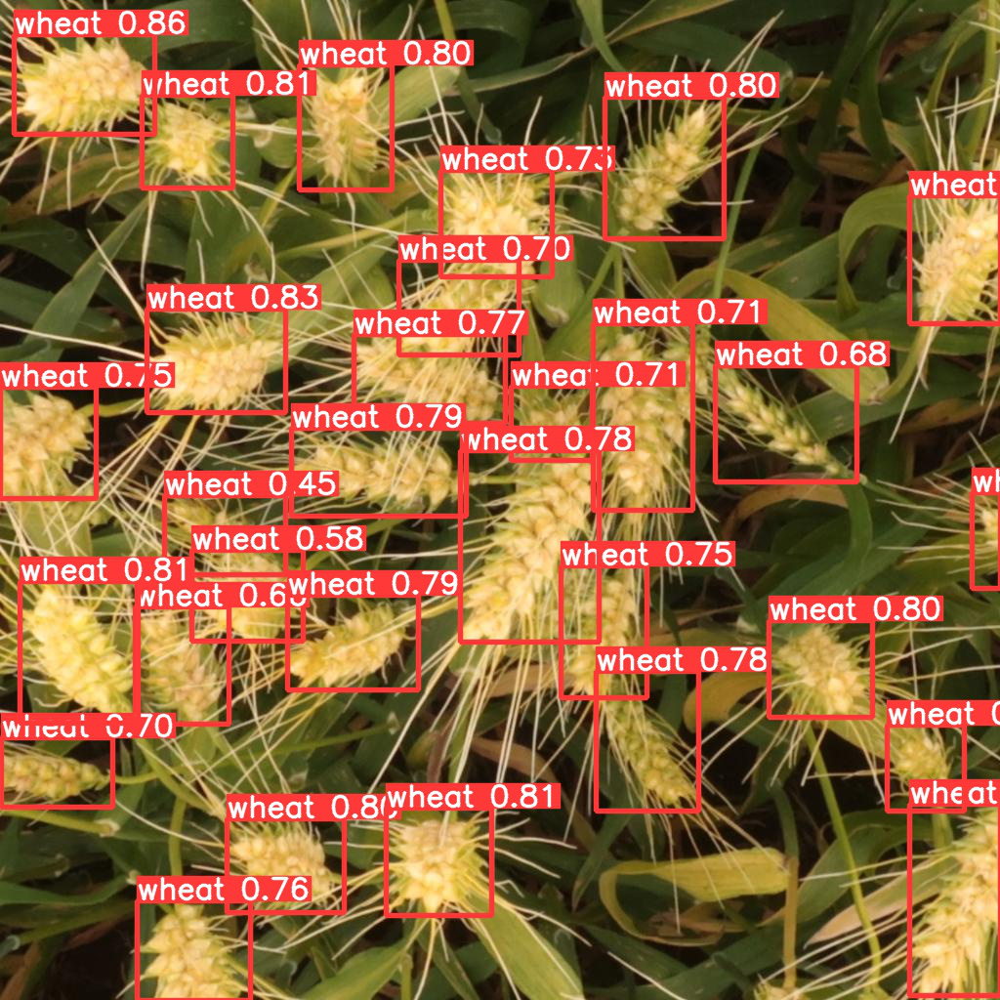


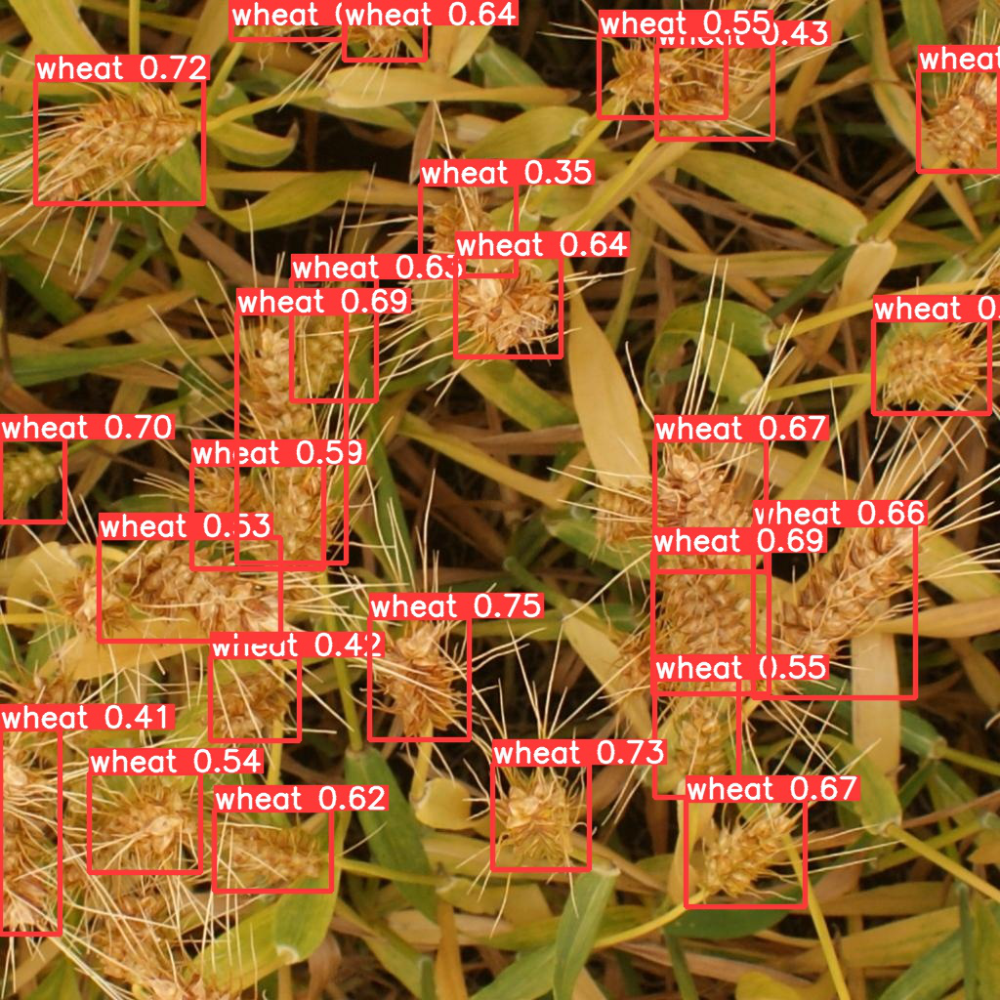

In [41]:
from skimage import io
import plotly.express as px
import plotly.graph_objs as go

def showImages(image_dir: "path to image directory"):
    """
    visualize images in a directory
    
    """
    imgs_paths = glob(image_dir + "/*jpg")
    numImgs = len(imgs_paths)
   
    for i in range(numImgs):
        img = io.imread(imgs_paths[i])
        fig = px.imshow(img)
        fig.show()
    
showImages(image_dir = "yolov5/runs/detect/exp")

In [45]:
!zip -r /content/logs.zip /content/yolov5/

Streaming output truncated to the last 5000 lines.
  adding: content/yolov5/output/labels/train/08a55ca8a.txt (deflated 61%)
  adding: content/yolov5/output/labels/train/1696dab5e.txt (deflated 61%)
  adding: content/yolov5/output/labels/train/70b617a5e.txt (deflated 61%)
  adding: content/yolov5/output/labels/train/1ee6b9669.txt (deflated 57%)
  adding: content/yolov5/output/labels/train/5f27c9778.txt (deflated 65%)
  adding: content/yolov5/output/labels/train/b70c20580.txt (deflated 65%)
  adding: content/yolov5/output/labels/train/82890548b.txt (deflated 60%)
  adding: content/yolov5/output/labels/train/c8b81529c.txt (deflated 61%)
  adding: content/yolov5/output/labels/train/0bb1adbd8.txt (deflated 62%)
  adding: content/yolov5/output/labels/train/20a86a215.txt (deflated 64%)
  adding: content/yolov5/output/labels/train/9780d64f5.txt (deflated 62%)
  adding: content/yolov5/output/labels/train/ccb8097e3.txt (deflated 57%)
  adding: content/yolov5/output/labels/train/5b13b8160.txt (d

In [48]:
from google.colab import files
files.download("/content/logs.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>